<a href="https://colab.research.google.com/github/SubbulakshmiSN/Sentiment_Analysis_NLP_AmazonReviews/blob/main/AmazonReviews.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# *`AMAZON REVIEWS SENTIMENT ANALYSIS`*

# *`IMPORTING LIBRARIES`*

In [1]:
!pip install Lazypredict

In [2]:
import pandas as pd
import numpy as np


#Preprocessing
from sklearn.preprocessing import OrdinalEncoder
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

#Visualization
import seaborn as sns
import matplotlib.pyplot as plt

#Machine Learning identifying algorithms/Model
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.calibration import CalibratedClassifierCV
import nltk

#Machine Learning Training
from lazypredict.Supervised import LazyClassifier


#Machine Learning Evaluation
from sklearn.metrics import  precision_score, recall_score, classification_report, accuracy_score,confusion_matrix # Classification
import joblib

# *`READ THE DATA`*

In [43]:
df=pd.read_csv("/content/amazonreviews.csv",sep="\t")
df

,label,review
0,pos,Stuning even for the non-gamer: This sound tra...
1,pos,The best soundtrack ever to anything.: I'm rea...
2,pos,Amazing!: This soundtrack is my favorite music...
3,pos,Excellent Soundtrack: I truly like this soundt...
4,pos,"Remember, Pull Your Jaw Off The Floor After He..."
5,pos,an absolute masterpiece: I am quite sure any o...
6,neg,"Buyer beware: This is a self-published book, a..."
7,pos,Glorious story: I loved Whisper of the wicked ...
8,pos,A FIVE STAR BOOK: I just finished reading Whis...
9,pos,Whispers of the Wicked Saints: This was a easy...


# *`DATA OBSERVATION`*

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   label   10000 non-null  object
 1   review  10000 non-null  object
dtypes: object(2)
memory usage: 156.4+ KB


In [21]:
df.label.value_counts()

label
neg    5097
pos    4903
Name: count, dtype: int64

In [22]:
df.isnull().sum()

label     0
review    0
dtype: int64

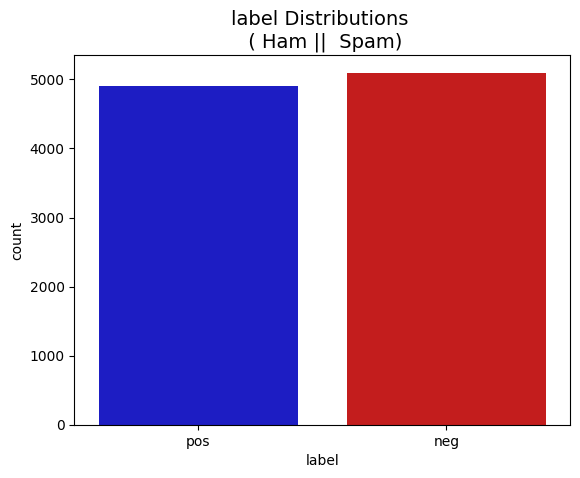

In [23]:
colors= ["#0101DF", "#DF0101"]
sns.countplot(x="label", data=df, palette=colors)
plt.title('label Distributions \n ( Ham ||  Spam)', fontsize=14)
plt.show()

# *`DATA PREPROCESSING`*

In [44]:
#encoding the labels

df["label"] = df["label"].map({"pos": 1, "neg": 0})

# *`SENTIMENT ANALYSIS USING NLP`*

In [34]:
nltk.download("vader_lexicon")

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


True

In [35]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer
sid = SentimentIntensityAnalyzer()

In [45]:
df["scores"]=df["review"].apply(lambda review: sid.polarity_scores(review))
df

,label,review,scores
0,1,Stuning even for the non-gamer: This sound tra...,"{'neg': 0.088, 'neu': 0.669, 'pos': 0.243, 'co..."
1,1,The best soundtrack ever to anything.: I'm rea...,"{'neg': 0.018, 'neu': 0.837, 'pos': 0.145, 'co..."
2,1,Amazing!: This soundtrack is my favorite music...,"{'neg': 0.04, 'neu': 0.692, 'pos': 0.268, 'com..."
3,1,Excellent Soundtrack: I truly like this soundt...,"{'neg': 0.09, 'neu': 0.615, 'pos': 0.295, 'com..."
4,1,"Remember, Pull Your Jaw Off The Floor After He...","{'neg': 0.0, 'neu': 0.746, 'pos': 0.254, 'comp..."
5,1,an absolute masterpiece: I am quite sure any o...,"{'neg': 0.014, 'neu': 0.737, 'pos': 0.249, 'co..."
6,0,"Buyer beware: This is a self-published book, a...","{'neg': 0.124, 'neu': 0.806, 'pos': 0.069, 'co..."
7,1,Glorious story: I loved Whisper of the wicked ...,"{'neg': 0.072, 'neu': 0.583, 'pos': 0.346, 'co..."
8,1,A FIVE STAR BOOK: I just finished reading Whis...,"{'neg': 0.113, 'neu': 0.712, 'pos': 0.174, 'co..."
9,1,Whispers of the Wicked Saints: This was a easy...,"{'neg': 0.033, 'neu': 0.777, 'pos': 0.19, 'com..."


In [46]:
df["compound"] = df["scores"].apply(lambda x:x["compound"])
df

,label,review,scores,compound
0,1,Stuning even for the non-gamer: This sound tra...,"{'neg': 0.088, 'neu': 0.669, 'pos': 0.243, 'co...",0.95
1,1,The best soundtrack ever to anything.: I'm rea...,"{'neg': 0.018, 'neu': 0.837, 'pos': 0.145, 'co...",0.90
2,1,Amazing!: This soundtrack is my favorite music...,"{'neg': 0.04, 'neu': 0.692, 'pos': 0.268, 'com...",0.99
3,1,Excellent Soundtrack: I truly like this soundt...,"{'neg': 0.09, 'neu': 0.615, 'pos': 0.295, 'com...",0.98
4,1,"Remember, Pull Your Jaw Off The Floor After He...","{'neg': 0.0, 'neu': 0.746, 'pos': 0.254, 'comp...",0.98
5,1,an absolute masterpiece: I am quite sure any o...,"{'neg': 0.014, 'neu': 0.737, 'pos': 0.249, 'co...",0.99
6,0,"Buyer beware: This is a self-published book, a...","{'neg': 0.124, 'neu': 0.806, 'pos': 0.069, 'co...",-0.87
7,1,Glorious story: I loved Whisper of the wicked ...,"{'neg': 0.072, 'neu': 0.583, 'pos': 0.346, 'co...",0.99
8,1,A FIVE STAR BOOK: I just finished reading Whis...,"{'neg': 0.113, 'neu': 0.712, 'pos': 0.174, 'co...",0.84
9,1,Whispers of the Wicked Saints: This was a easy...,"{'neg': 0.033, 'neu': 0.777, 'pos': 0.19, 'com...",0.82


In [41]:
pd.set_option('display.max_rows', None)

In [48]:
def categorize_sentiment(compound_score):
    # Define thresholds for sentiment categories
    if compound_score > 0.6:
        return 1
    elif compound_score < 0.06:
        return 0
    else:
        return -1

# Apply the function to categorize each review based on the compound score
df['sentiment'] = df['compound'].apply(categorize_sentiment)

df

,label,review,scores,compound,sentiment
0,1,Stuning even for the non-gamer: This sound tra...,"{'neg': 0.088, 'neu': 0.669, 'pos': 0.243, 'co...",0.95,1
1,1,The best soundtrack ever to anything.: I'm rea...,"{'neg': 0.018, 'neu': 0.837, 'pos': 0.145, 'co...",0.90,1
2,1,Amazing!: This soundtrack is my favorite music...,"{'neg': 0.04, 'neu': 0.692, 'pos': 0.268, 'com...",0.99,1
3,1,Excellent Soundtrack: I truly like this soundt...,"{'neg': 0.09, 'neu': 0.615, 'pos': 0.295, 'com...",0.98,1
4,1,"Remember, Pull Your Jaw Off The Floor After He...","{'neg': 0.0, 'neu': 0.746, 'pos': 0.254, 'comp...",0.98,1
5,1,an absolute masterpiece: I am quite sure any o...,"{'neg': 0.014, 'neu': 0.737, 'pos': 0.249, 'co...",0.99,1
6,0,"Buyer beware: This is a self-published book, a...","{'neg': 0.124, 'neu': 0.806, 'pos': 0.069, 'co...",-0.87,0
7,1,Glorious story: I loved Whisper of the wicked ...,"{'neg': 0.072, 'neu': 0.583, 'pos': 0.346, 'co...",0.99,1
8,1,A FIVE STAR BOOK: I just finished reading Whis...,"{'neg': 0.113, 'neu': 0.712, 'pos': 0.174, 'co...",0.84,1
9,1,Whispers of the Wicked Saints: This was a easy...,"{'neg': 0.033, 'neu': 0.777, 'pos': 0.19, 'com...",0.82,1


In [49]:
df.sentiment.value_counts()

sentiment
 1    5328
 0    3277
-1    1395
Name: count, dtype: int64

In [50]:
accuracy_score(df["label"],df["sentiment"])

0.665

In [52]:
def categorize_sentiment(compound_score):
    # Define thresholds for sentiment categories
    if compound_score > 0.6:
        return 1

    else:
        return 0

# Apply the function to categorize each review based on the compound score
df['sentiment'] = df['compound'].apply(categorize_sentiment)
df

,label,review,scores,compound,sentiment
0,1,Stuning even for the non-gamer: This sound tra...,"{'neg': 0.088, 'neu': 0.669, 'pos': 0.243, 'co...",0.95,1
1,1,The best soundtrack ever to anything.: I'm rea...,"{'neg': 0.018, 'neu': 0.837, 'pos': 0.145, 'co...",0.90,1
2,1,Amazing!: This soundtrack is my favorite music...,"{'neg': 0.04, 'neu': 0.692, 'pos': 0.268, 'com...",0.99,1
3,1,Excellent Soundtrack: I truly like this soundt...,"{'neg': 0.09, 'neu': 0.615, 'pos': 0.295, 'com...",0.98,1
4,1,"Remember, Pull Your Jaw Off The Floor After He...","{'neg': 0.0, 'neu': 0.746, 'pos': 0.254, 'comp...",0.98,1
5,1,an absolute masterpiece: I am quite sure any o...,"{'neg': 0.014, 'neu': 0.737, 'pos': 0.249, 'co...",0.99,1
6,0,"Buyer beware: This is a self-published book, a...","{'neg': 0.124, 'neu': 0.806, 'pos': 0.069, 'co...",-0.87,0
7,1,Glorious story: I loved Whisper of the wicked ...,"{'neg': 0.072, 'neu': 0.583, 'pos': 0.346, 'co...",0.99,1
8,1,A FIVE STAR BOOK: I just finished reading Whis...,"{'neg': 0.113, 'neu': 0.712, 'pos': 0.174, 'co...",0.84,1
9,1,Whispers of the Wicked Saints: This was a easy...,"{'neg': 0.033, 'neu': 0.777, 'pos': 0.19, 'com...",0.82,1


In [54]:
df.sentiment.value_counts()

sentiment
1    5328
0    4672
Name: count, dtype: int64

In [55]:
accuracy_score(df["label"],df["sentiment"])

0.7523



> `initially the accuracy is 0.6 when neutral is considered, when changing the threshold to 0.6 and ignoring neutral score from compound  the accuracy is 0.7.`

